# Imports

In [1]:
# pip install -r requirements.txt

In [2]:
import pandas as pd
import numpy as np

import datetime as dt
from collections import Counter, defaultdict

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go


from sklearn.impute import KNNImputer
from sklearn.preprocessing import PowerTransformer, RobustScaler, OneHotEncoder, LabelEncoder
from sklearn.metrics import silhouette_score, silhouette_samples, calinski_harabasz_score, davies_bouldin_score
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.neighbors import NearestNeighbors

from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering, MeanShift
from minisom import MiniSom
from sklearn.decomposition import PCA
from umap import UMAP
import scipy.cluster.hierarchy as sch

from mlxtend.preprocessing import TransactionEncoder
from mlxtend.frequent_patterns import apriori, association_rules


import warnings
warnings.filterwarnings("ignore")  # Suppress all warnings

from my_functions import *  
from model_selection import *
from visualizations import *
%load_ext autoreload
%autoreload 2


np.random.seed(40)
pd.set_option('display.max_columns', None)

In [3]:
# Load datasets
basket_df = pd.read_csv('data/customer_basket.csv')
info_df = pd.read_csv('data/customer_info.csv')

# Exploratory Data Analysis

In [4]:
basket_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 3 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   invoice_id     100000 non-null  int64 
 1   list_of_goods  100000 non-null  object
 2   customer_id    100000 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 2.3+ MB


In [5]:
basket_df.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
invoice_id,100000.0,NaN,NaN,NaN,6124713.66375,3533207.950417,20054.0,3066431.5,6118618.0,9195346.75,12242220.0
list_of_goods,100000,98742,['oil'],33,NaN,NaN,NaN,NaN,NaN,NaN,NaN
customer_id,100000.0,NaN,NaN,NaN,16945.56902,9837.987201,1.0,8425.0,16917.0,25536.0,34060.0


In [6]:
basket_df.head()

,invoice_id,list_of_goods,customer_id
0,5062209,"['megaman zero 3', 'energy bar', 'pokemon viol...",4925
1,4272512,"['black beer', 'bramble', 'laptop', 'pokemon v...",19046
2,7121052,"['soup', 'shallot', 'cake', 'fresh bread', 'cr...",10318
3,5847748,"['soup', 'cooking oil', 'cereals', 'oil', 'dog...",27283
4,6336114,"['eggplant', 'mint green tea', 'oil', 'bacon',...",16072


In [7]:
info_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34060 entries, 0 to 34059
Data columns (total 26 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Unnamed: 0                               34060 non-null  int64  
 1   customer_id                              34060 non-null  int64  
 2   customer_name                            34060 non-null  object 
 3   customer_gender                          34060 non-null  object 
 4   customer_birthdate                       33719 non-null  object 
 5   kids_home                                33311 non-null  float64
 6   teens_home                               33277 non-null  float64
 7   number_complaints                        33038 non-null  float64
 8   distinct_stores_visited                  33379 non-null  float64
 9   lifetime_spend_groceries                 34060 non-null  float64
 10  lifetime_spend_electronics               34060

In [8]:
info_df.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Unnamed: 0,34060.0,NaN,NaN,NaN,17029.5,9832.419421,0.0,8514.75,17029.5,25544.25,34059.0
customer_id,34060.0,NaN,NaN,NaN,20010.854433,11557.889072,1.0,10018.75,19985.5,30042.25,40000.0
customer_name,34060,33579,Robert Brown,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN
customer_gender,34060,2,male,17133,NaN,NaN,NaN,NaN,NaN,NaN,NaN
customer_birthdate,33719,33710,12/23/1956 11:57 PM,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
kids_home,33311.0,NaN,NaN,NaN,1.170244,1.307319,0.0,0.0,1.0,1.0,10.0
teens_home,33277.0,NaN,NaN,NaN,0.936292,0.759579,0.0,0.0,1.0,1.0,4.0
number_complaints,33038.0,NaN,NaN,NaN,0.832042,0.771205,0.0,0.0,1.0,1.0,4.0
distinct_stores_visited,33379.0,NaN,NaN,NaN,2.914078,1.549081,1.0,2.0,3.0,4.0,10.0
lifetime_spend_groceries,34060.0,NaN,NaN,NaN,22818.404698,20098.763199,0.0,9346.0,15877.5,30428.25,158544.0


In [9]:
# Percentage of missing values in each column
for col in info_df.columns:
    pct_missing = np.mean(info_df[col].isnull())
    print('{} - {}%'.format(col, round(pct_missing*100)))

Unnamed: 0 - 0%
customer_id - 0%
customer_name - 0%
customer_gender - 0%
customer_birthdate - 1%
kids_home - 2%
teens_home - 2%
number_complaints - 3%
distinct_stores_visited - 2%
lifetime_spend_groceries - 0%
lifetime_spend_electronics - 0%
typical_hour - 4%
lifetime_spend_vegetables - 3%
lifetime_spend_nonalcohol_drinks - 0%
lifetime_spend_alcohol_drinks - 2%
lifetime_spend_meat - 0%
lifetime_spend_fish - 5%
lifetime_spend_hygiene - 0%
lifetime_spend_videogames - 0%
lifetime_spend_petfood - 0%
lifetime_total_distinct_products - 0%
percentage_of_products_bought_promotion - 0%
year_first_transaction - 0%
loyalty_card_number - 32%
latitude - 0%
longitude - 0%


In [10]:
# Percentage of missing values in each column
for col in basket_df.columns:
    pct_missing = np.mean(basket_df[col].isnull())
    print('{} - {}%'.format(col, round(pct_missing*100)))

invoice_id - 0%
list_of_goods - 0%
customer_id - 0%


# Preprocessing

In [11]:
# Get all new features for info_df
info_df = feature_engineering_info(info_df)

In [12]:
# Get all new features for basket_df
basket_df = feature_engineering_basket(basket_df)

In [13]:
# Get a full list of all items purchased for each customer (with repetitions)
all_items = all_purchased_items(basket_df)

In [14]:
all_items.head()

,customer_id,all_purchased_items
0,1,"[pickles, protein bar, mashed potato, beer, tu..."
1,2,"[shampoo, tooth brush, portal, vegetables mix,..."
2,4,"[shallot, mashed potato, olive oil, asparagus,..."
3,5,"[candy bars, zucchini, mint green tea, strong ..."
4,6,"[candy bars, gadget for tiktok streaming, port..."


# Visualization

## General data visualization

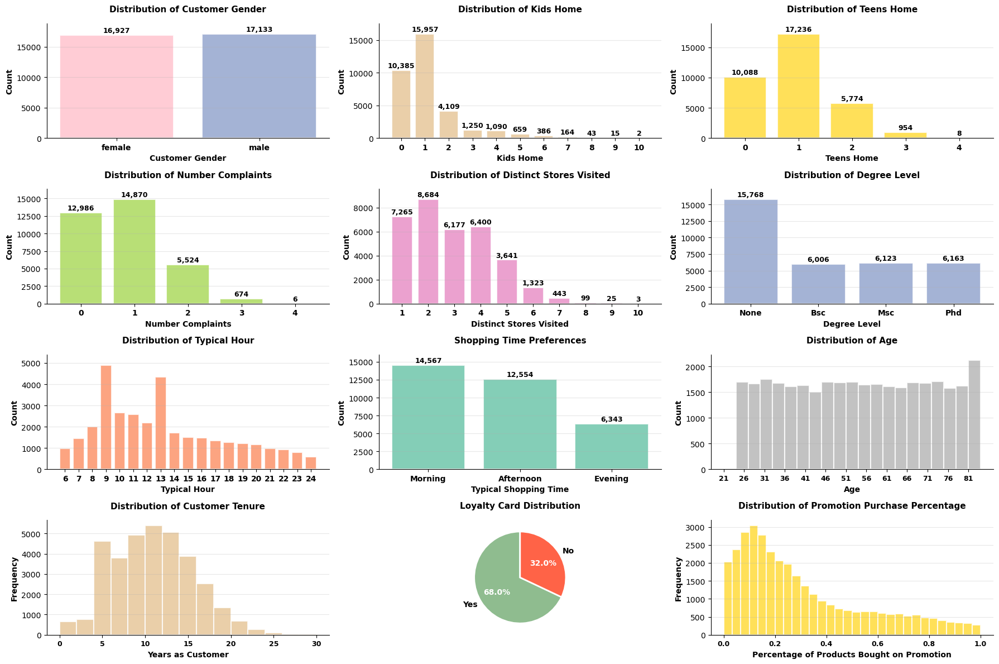

In [15]:
general_visualization(info_df)

## Customer spending visualization

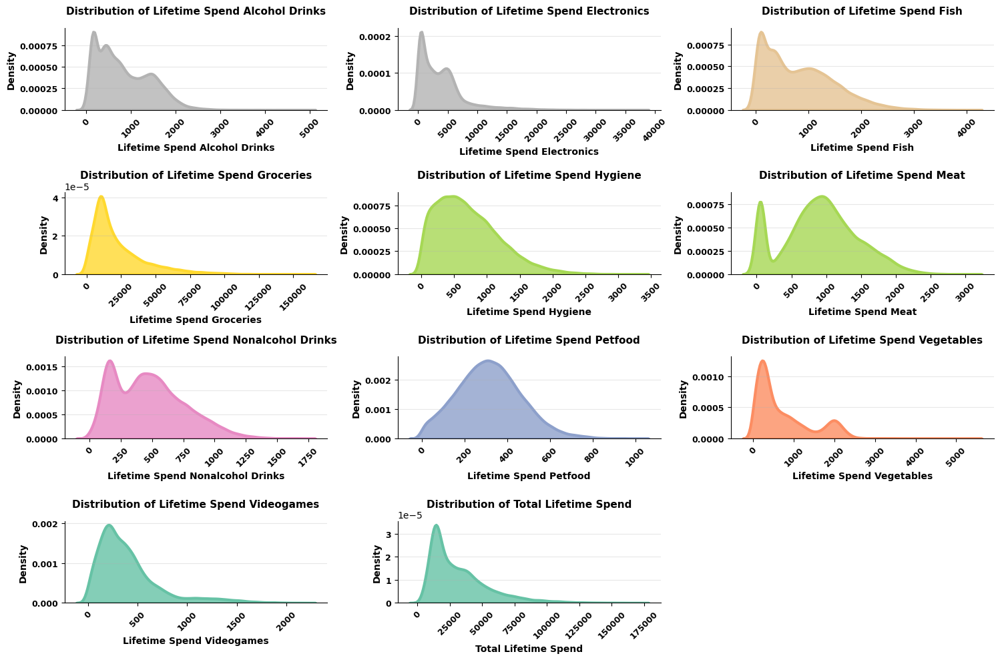

In [16]:
spending_visualization(info_df, [col for col in info_df.columns if 'lifetime_spend' in col])

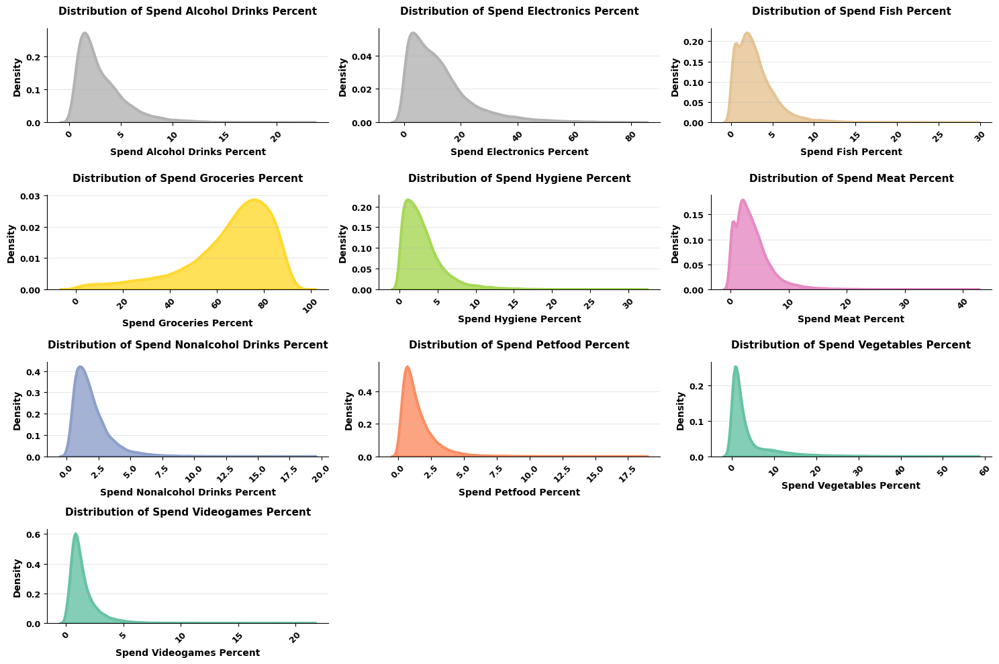

In [17]:
spending_visualization(info_df, [col for col in info_df.columns if '_percent' in col])

## Geographical visualization

In [18]:
plot_map(info_df)

## Correlations visualization

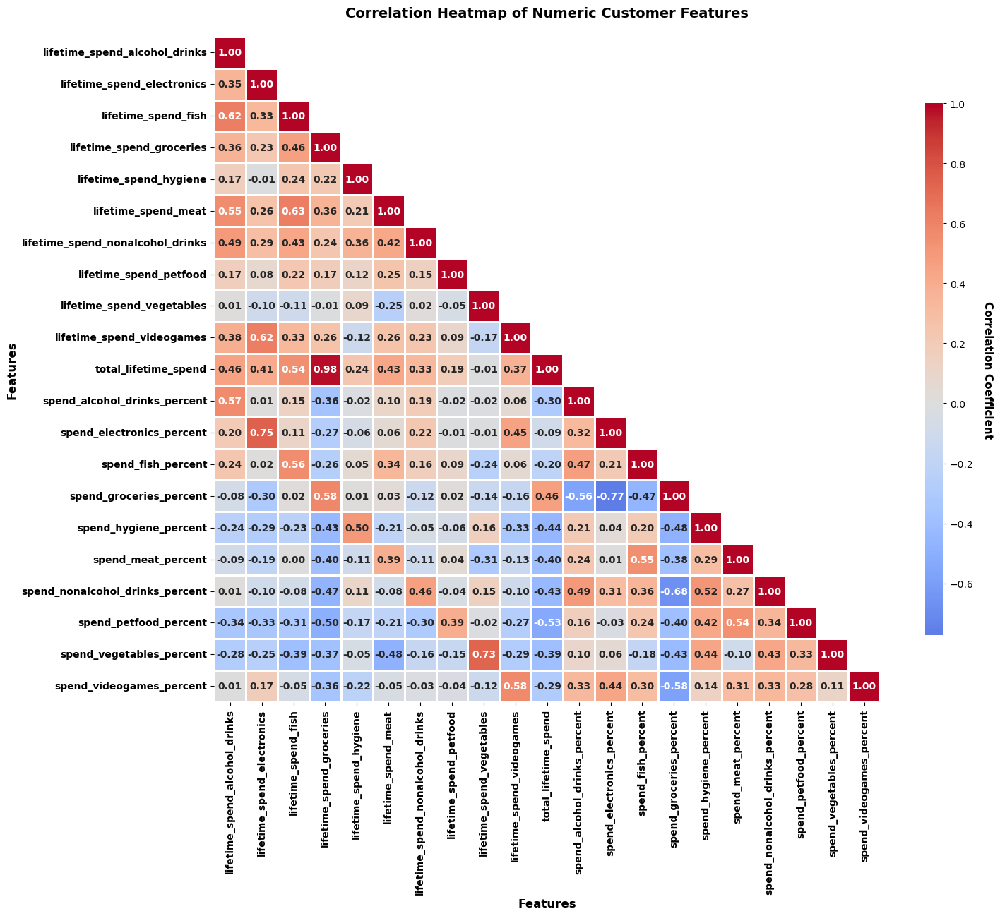

In [19]:
# Plot the correlation between lifetime spend and percentage spend
plot_correlation_heatmap(info_df, [col for col in info_df.columns if 'spend' in col])

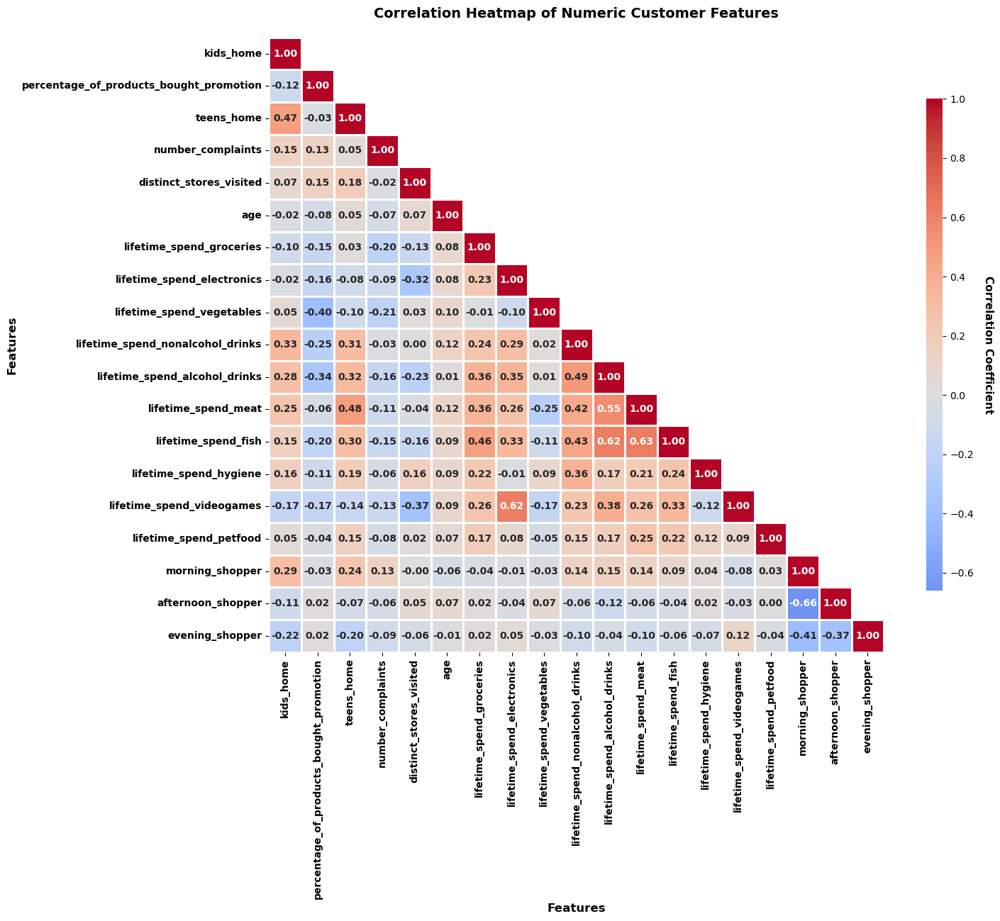

In [20]:
# Define the columns to plot
columns = ['kids_home', 'percentage_of_products_bought_promotion', 'teens_home', 'number_complaints', 
                   'distinct_stores_visited', 'age', 'lifetime_spend_groceries', 'lifetime_spend_electronics', 
                   'lifetime_spend_vegetables', 'lifetime_spend_nonalcohol_drinks', 'lifetime_spend_alcohol_drinks', 
                   'lifetime_spend_meat', 'lifetime_spend_fish', 'lifetime_spend_hygiene', 'lifetime_spend_videogames', 
                   'lifetime_spend_petfood', 'morning_shopper', 'afternoon_shopper', 'evening_shopper']

# Plot the correlation heatmap for the specified columns
plot_correlation_heatmap(info_df, columns)

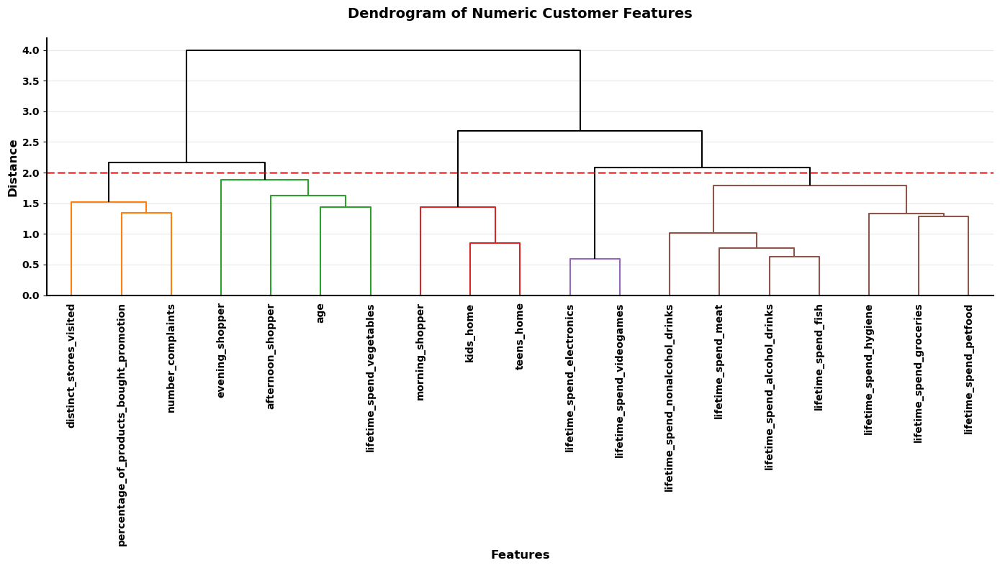

In [21]:
dendogram_visualization(info_df, columns)

## Basket visualization

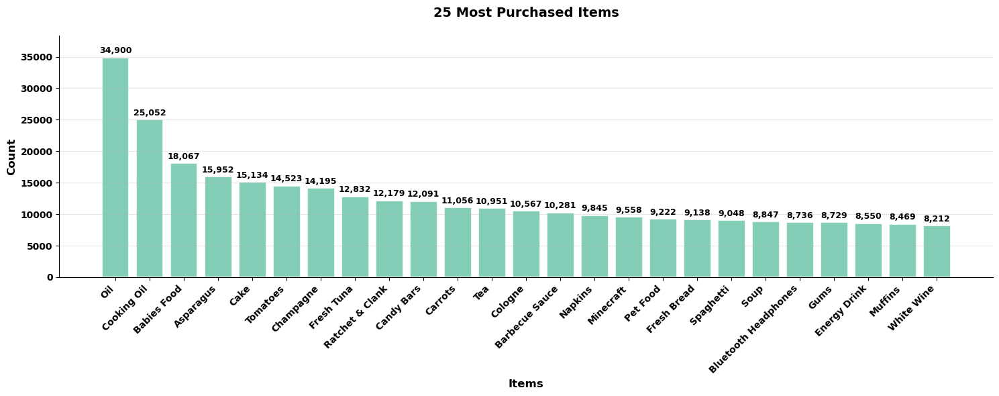

In [22]:
plot_top_purchased_items(all_items, 25)

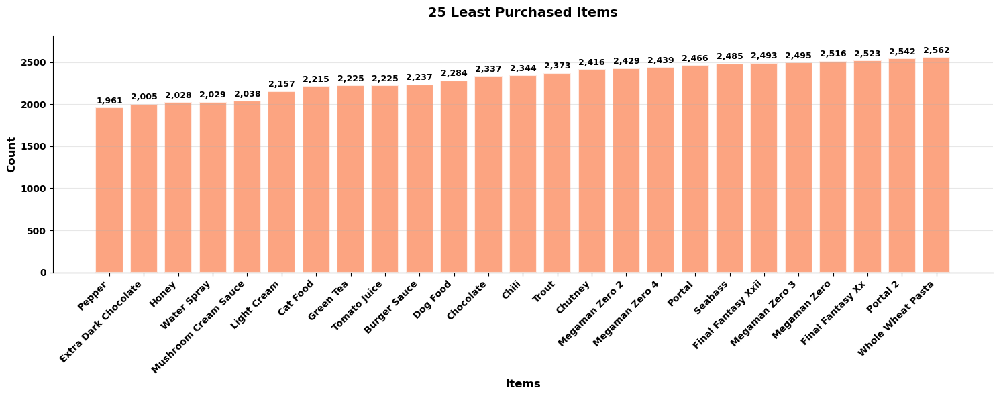

In [23]:
plot_top_purchased_items(all_items, 25, 'least')

# Clustering

## Imputation and Scaling

In [67]:
# Perform some extra preprocessing on info_df, after seeing the visualizations
# Create a new DataFrame with encoded categorical columns and scaled features
# Separate makro clients
info_df_scaled, makro_clients = extra_preprocessing(info_df)

# Check the shape of the scaled DataFrame
info_df_scaled.shape

(33963, 33)

## Removing outliers with DBScan

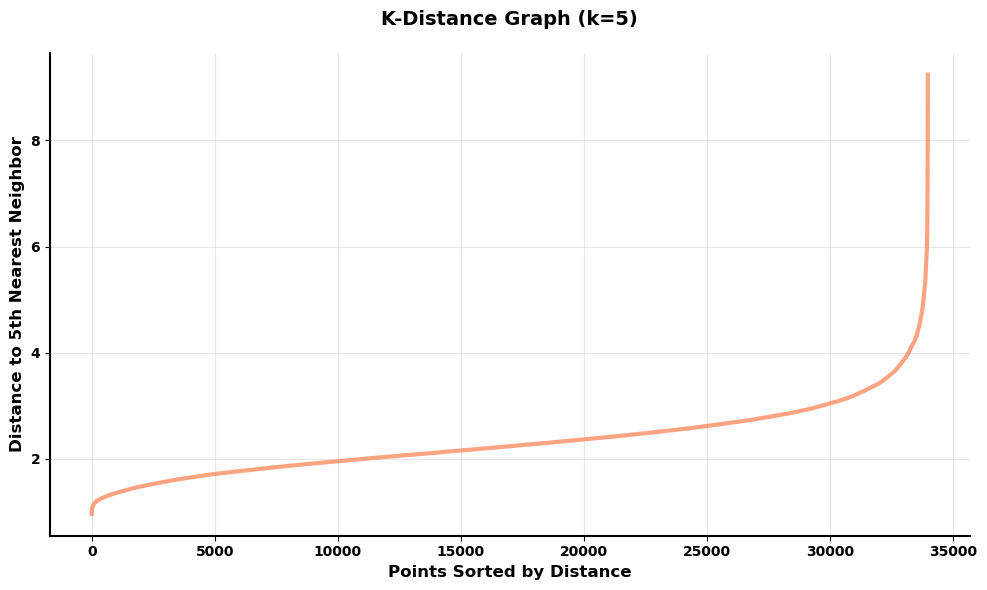

In [25]:
# Plot the k-distance graph to find the DBSCAN epsilon parameter
k_distance_graph(info_df_scaled.drop(columns=['customer_id']), k=5)

In [26]:
# Set range of eps values based on the k-distance plot
eps_range = [4.3, 4.4, 4.5, 4.6]   
min_samples_range = [4, 6, 8]

# Test DBSCAN parameters 
test_dbscan_params(info_df_scaled.drop(columns=['customer_id']), eps_range, min_samples_range)

eps=4.30, min_samples=4: 2 clusters, 193 outliers (0.6%)
eps=4.30, min_samples=6: 1 clusters, 210 outliers (0.6%)
eps=4.30, min_samples=8: 1 clusters, 232 outliers (0.7%)
eps=4.40, min_samples=4: 2 clusters, 172 outliers (0.5%)
eps=4.40, min_samples=6: 1 clusters, 184 outliers (0.5%)
eps=4.40, min_samples=8: 1 clusters, 200 outliers (0.6%)
eps=4.50, min_samples=4: 1 clusters, 149 outliers (0.4%)
eps=4.50, min_samples=6: 1 clusters, 161 outliers (0.5%)
eps=4.50, min_samples=8: 1 clusters, 167 outliers (0.5%)
eps=4.60, min_samples=4: 1 clusters, 133 outliers (0.4%)
eps=4.60, min_samples=6: 1 clusters, 142 outliers (0.4%)
eps=4.60, min_samples=8: 1 clusters, 150 outliers (0.4%)


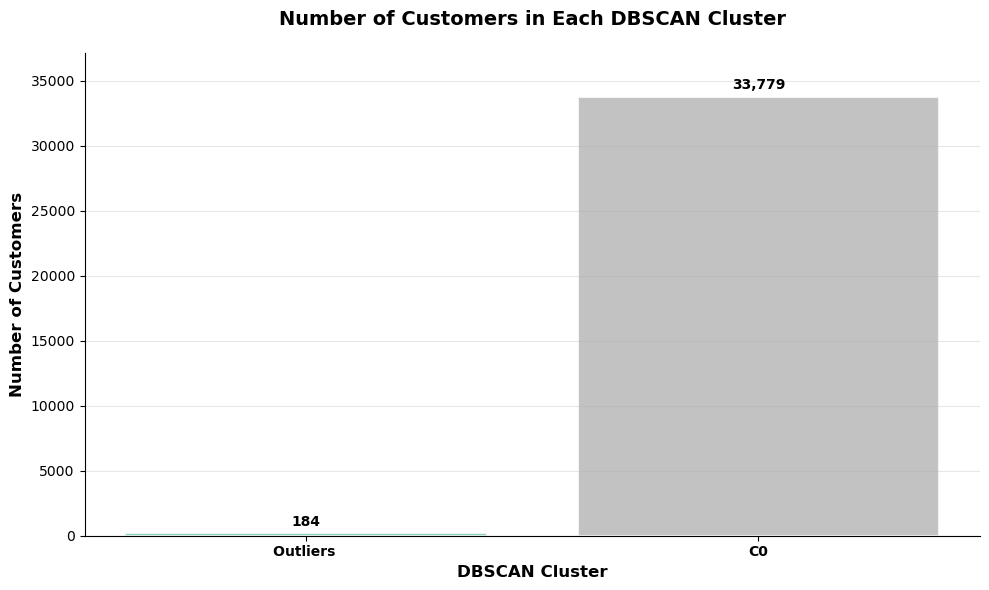

Number of outliers removed: 184


In [68]:
# We are going to use a higher value of eps to check for multidimentional outliers
# If there are any, we will remove them from the main dataset and keep in a separate DataFrame      
info_df_scaled_no_outliers, outliers_df = remove_outliers(info_df_scaled, 4.4, 6)   

In [28]:
# Check where are the outliers located on the map
plot_map(info_df.merge(outliers_df[['customer_id']], on='customer_id', how='right'))

## Dimensionality reduction with PCA

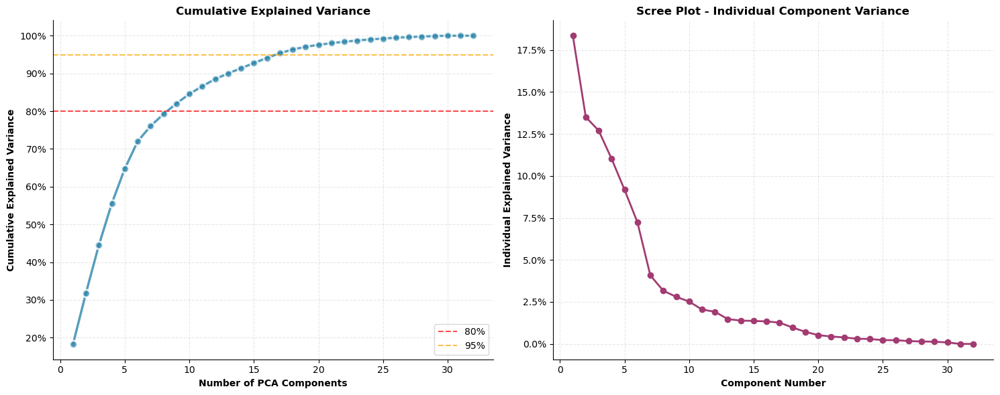

In [29]:
plot_pca_explained_variance(info_df_scaled_no_outliers)

In [69]:
# Reduce the dimensionality of the dataset by applying PCA
info_df_pca, outliers_df_pca = dimensionality_reduction(info_df_scaled_no_outliers, outliers_df, 12)  

Variance explained by each component: [0.18345557 0.13505067 0.12697902 0.11019502 0.09179724 0.07240893
 0.04077041 0.0316911  0.02802647 0.02522244 0.02047071 0.01913024]
Total variance explained by 12 components: 88.52%


## Model selection

Finding optimal k using silhouette score...
Optimal number of clusters determined: 8
Running Hierarchical Clustering...
Running K-Means...
Running Self-Organizing Map clustering...
Running DBSCAN...
Running Mean Shift...
Running Gaussian Mixture Model...
Plotting clustering results...


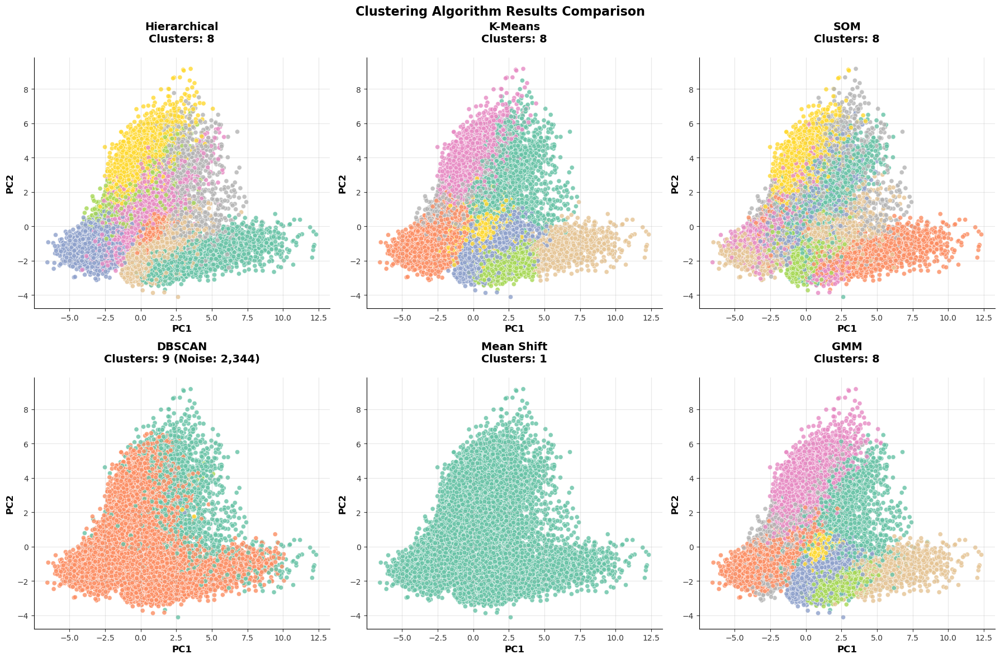

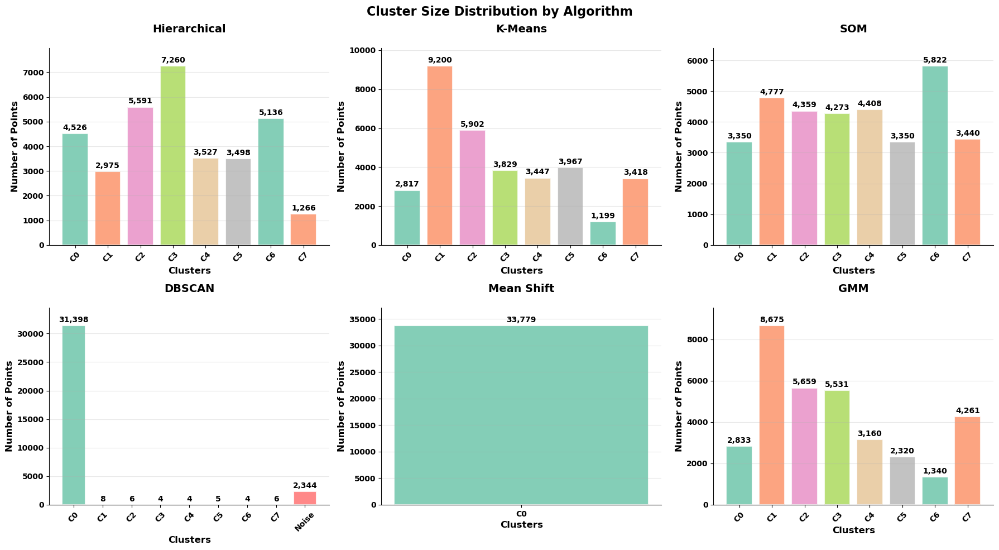


Clustering Comparison Results:
   Algorithm  Silhouette  Calinski-Harabasz  Davies-Bouldin  Clusters  Noise Points
Hierarchical       0.177             4452.3           1.751         8             0
     K-Means       0.212             5002.5           1.541         8             0
         SOM       0.069             2219.0           2.479         8             0
      DBSCAN       0.070               10.8           0.962         8          2344
         GMM       0.171             4205.8           1.779         8             0

Best Silhouette Score: K-Means


In [31]:
results, scores = clustering_comparison(info_df_pca.drop(columns=['customer_id']).values)

## K-Means

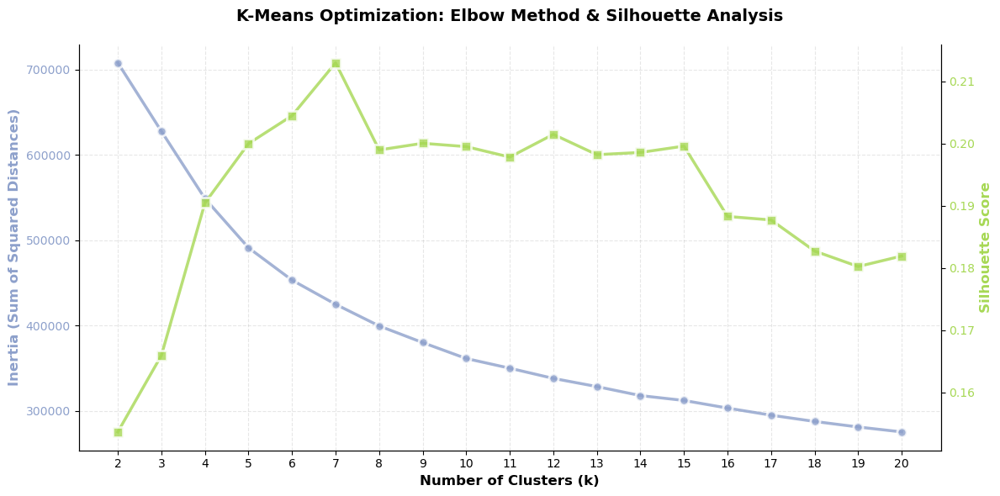

In [32]:
# Plot the inertia and silhouette scores for different values of k
plot_elbow_and_silhouette(info_df_pca, max_k=20)

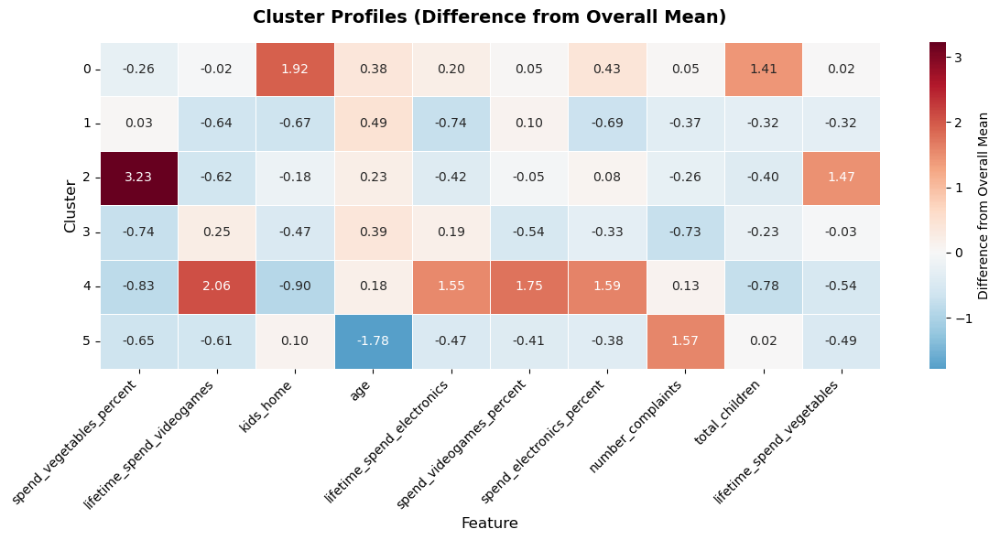

,age,degree_level_ordinal,distinct_stores_visited,kids_home,lifetime_spend_alcohol_drinks,lifetime_spend_electronics,lifetime_spend_fish,lifetime_spend_groceries,lifetime_spend_hygiene,lifetime_spend_meat,lifetime_spend_nonalcohol_drinks,lifetime_spend_petfood,lifetime_spend_vegetables,lifetime_spend_videogames,lifetime_total_distinct_products,loyalty_card,no_kids,number_complaints,percentage_of_products_bought_promotion,spend_alcohol_drinks_percent,spend_electronics_percent,spend_fish_percent,spend_groceries_percent,spend_hygiene_percent,spend_meat_percent,spend_nonalcohol_drinks_percent,spend_petfood_percent,spend_vegetables_percent,spend_videogames_percent,total_children,total_lifetime_spend,typical_hour
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.38,0.07,0.15,1.92,0.60,0.20,0.47,-0.29,0.36,0.78,0.70,0.20,0.02,-0.02,0.77,0.04,-0.11,0.05,-0.25,0.83,0.43,0.85,-0.62,0.32,0.59,0.81,-0.00,-0.26,0.05,1.41,-0.12,-0.36
1,0.49,-0.22,0.54,-0.67,-0.69,-0.74,-0.49,-0.59,-0.41,-0.14,-0.70,-0.03,-0.32,-0.64,-0.54,0.21,-0.02,-0.37,0.71,-0.61,-0.69,-0.05,0.26,0.20,0.99,-0.32,0.92,0.03,0.10,-0.32,-0.66,0.14
2,0.23,0.10,0.13,-0.18,-0.46,-0.42,-0.75,-0.60,-0.01,-1.25,-0.19,-0.35,1.47,-0.62,-0.43,-0.08,-0.11,-0.26,-0.61,-0.08,0.08,-0.86,-0.43,0.70,-0.95,0.64,0.25,3.23,-0.05,-0.40,-0.57,0.10
3,0.39,0.14,-0.09,-0.47,0.28,0.19,0.48,1.17,0.37,0.41,0.23,0.22,-0.03,0.25,0.27,0.07,-0.04,-0.73,-0.14,-0.38,-0.33,-0.18,0.60,-0.41,-0.43,-0.51,-0.60,-0.74,-0.54,-0.23,0.98,0.06
4,0.18,0.12,-0.75,-0.90,0.17,1.55,0.08,-0.19,-0.56,0.00,0.07,-0.07,-0.54,2.06,-0.14,-0.21,0.40,0.13,-0.05,0.10,1.59,0.08,-0.78,-0.64,-0.17,-0.13,-0.33,-0.83,1.75,-0.78,0.11,0.31
5,-1.78,-0.26,-0.16,0.10,-0.15,-0.47,-0.22,-0.35,-0.19,-0.34,-0.32,-0.20,-0.49,-0.61,-0.27,-0.15,0.02,1.57,0.33,0.31,-0.38,0.07,0.31,-0.04,-0.03,-0.16,0.08,-0.65,-0.41,0.02,-0.40,-0.13


In [70]:
# Using the graph above, cluster the data with k-means
k = 6
info_df_clustered = kmeans_clustering(info_df_pca, info_df_scaled, k)

# Cheak the custer profiles
cluster_profiles = generate_cluster_profiles(info_df_clustered)
cluster_profiles

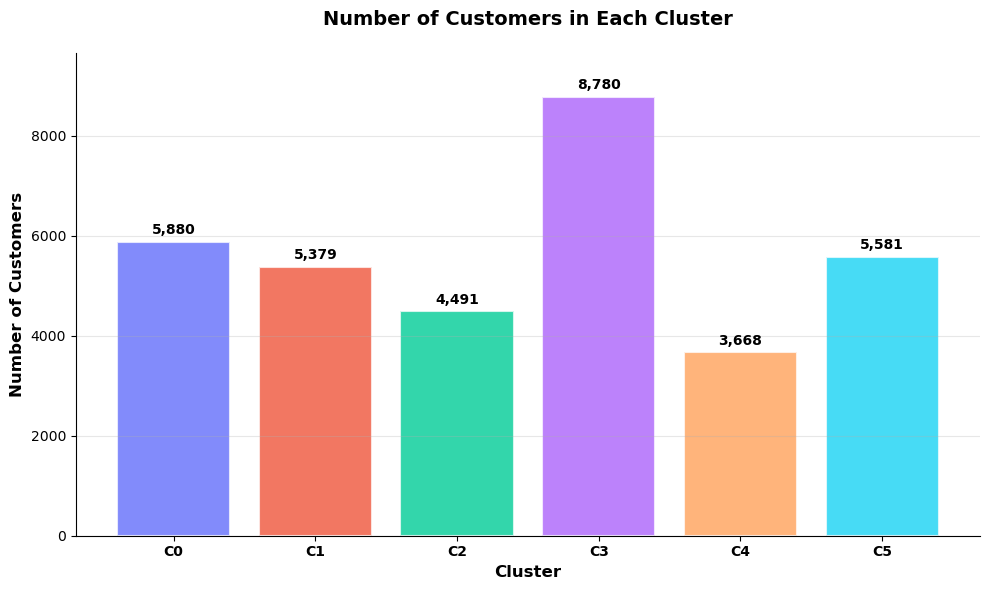

In [71]:
# Check the cluster sizes
plot_cluster_counts(info_df_clustered)

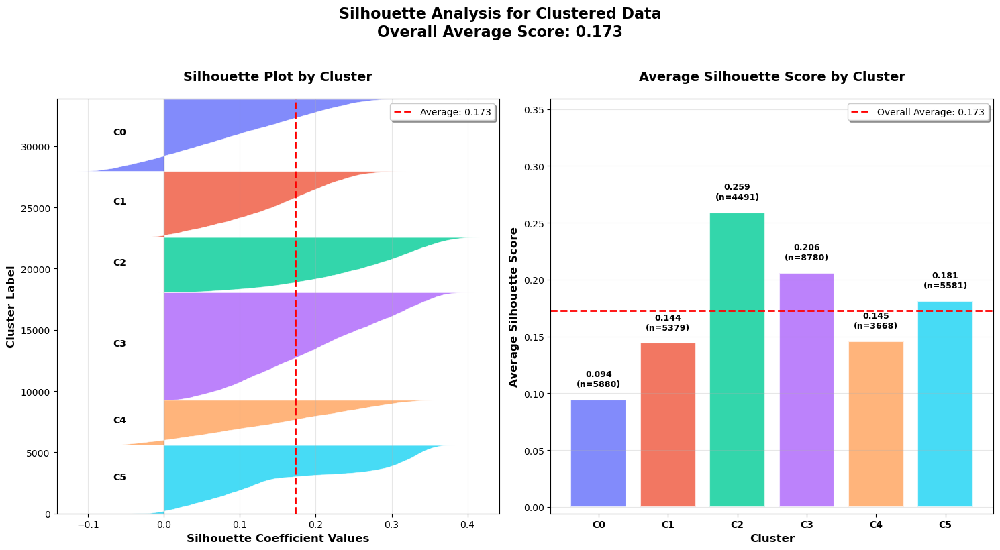

In [72]:
# Generate silhouette plot per cluster
silhouette_scores = plot_silhouette_analysis(info_df_clustered.drop(columns=['customer_id']))

In [73]:
# Generate cluster names (most significant features)
cluster_names = generate_cluster_names(cluster_profiles, z_threshold=0.7)

# Print cluster descriptions
for k, v in cluster_names.items():
    print(f"Cluster {k}: {v}\n")

Cluster 0: HIGH : kids home, total children, spend fish percent, spend alcohol drinks percent | LOW : spend groceries percent

Cluster 1: HIGH : spend meat percent, spend petfood percent, percentage of products bought promotion, distinct stores visited | LOW : lifetime spend electronics, lifetime spend nonalcohol drinks, lifetime spend alcohol drinks, spend electronics percent

Cluster 2: HIGH : spend vegetables percent, lifetime spend vegetables, spend hygiene percent, spend nonalcohol drinks percent | LOW : lifetime spend meat, spend meat percent, spend fish percent, lifetime spend fish

Cluster 3: HIGH : lifetime spend groceries, total lifetime spend, spend groceries percent, lifetime spend fish | LOW : spend vegetables percent, number complaints, spend petfood percent, spend videogames percent

Cluster 4: HIGH : lifetime spend videogames, spend videogames percent, spend electronics percent, lifetime spend electronics | LOW : kids home, spend vegetables percent, spend groceries perc

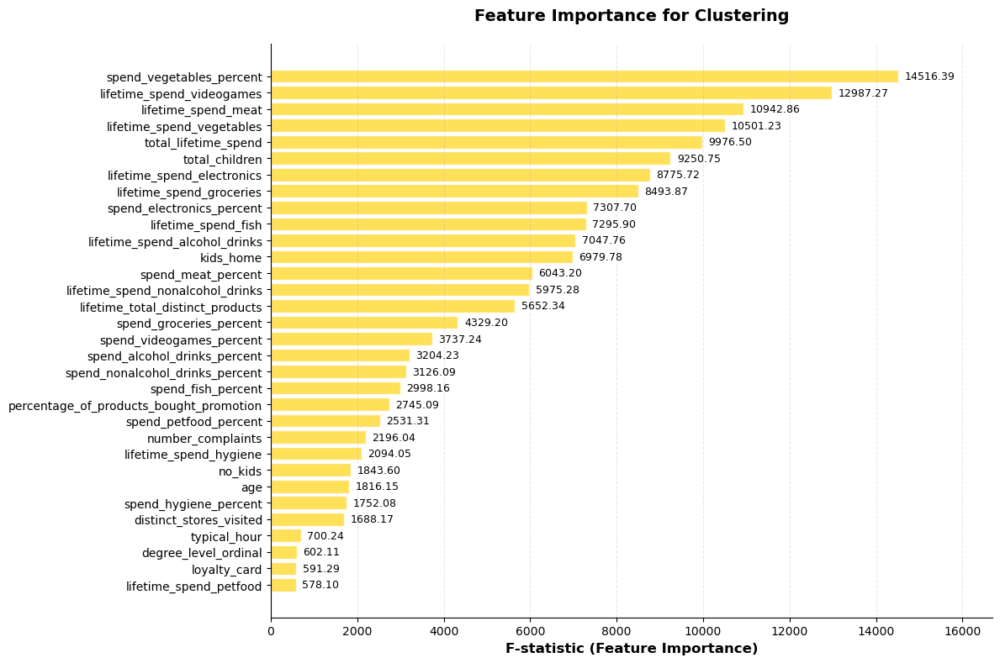

In [74]:
# Calculate and plot feature importance based on F-statistic
plot_feature_importance(info_df_clustered.drop(columns=['customer_id']))

## Repeated K-Means

In [75]:
# Get the top good clusters
n_good_clusters = 3
good_clusters = list(silhouette_scores.keys())[:n_good_clusters]

# Remove well defined clusters from info_df_pca 
well_clustered_customers = info_df_clustered[info_df_clustered['cluster'].isin(good_clusters)]['customer_id']
info_df_pca_remaining = info_df_pca[~info_df_pca['customer_id'].isin(well_clustered_customers)].drop(columns=['cluster']).reset_index(drop=True)

# Also deal with the info_df_scaled and info_df_clustered
info_df_scaled_remaining = info_df_scaled[~info_df_scaled['customer_id'].isin(well_clustered_customers)].reset_index(drop=True)
info_df_clustered = info_df_clustered[info_df_clustered['customer_id'].isin(well_clustered_customers)].reset_index(drop=True)

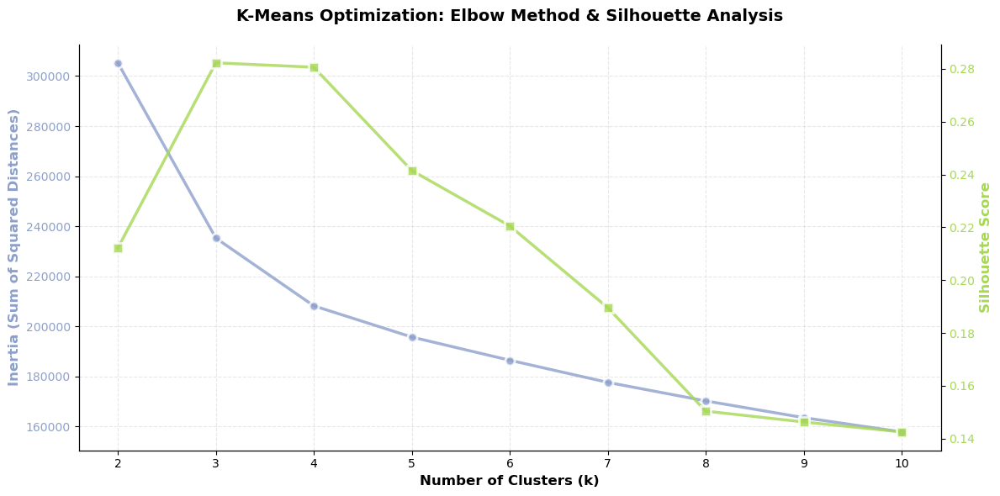

In [76]:
# Plot the inertia and silhouette scores for different values of k
plot_elbow_and_silhouette(info_df_pca_remaining, max_k=10)

In [77]:
# Run the k-means again
k = 3
info_df_clustered_remaining = kmeans_clustering(info_df_pca_remaining, info_df_scaled_remaining, k)

In [78]:
# Reassign cluster labels in info_df_clustered to be consecutive numbers starting from 1
le = LabelEncoder()
info_df_clustered['cluster'] = le.fit_transform(info_df_clustered['cluster']) + k 

# Combine info_df_clustered and info_df_clustered_remaining
info_df_clustered = pd.concat([info_df_clustered, info_df_clustered_remaining], axis=0).reset_index(drop=True)

In [79]:
# Mark Makro clients with the cluster number
makro_clients['cluster'] = max(info_df_clustered['cluster'].unique()) + 1

# Combine the clustered DataFrame with the original Makro clients
info_df_clustered = pd.concat([info_df_clustered, makro_clients], axis=0).reset_index(drop=True)

In [80]:
# Reassign cluster labels in info_df_clustered to be consecutive numbers starting from 1
le = LabelEncoder()
info_df_clustered['cluster'] = le.fit_transform(info_df_clustered['cluster']) + 1
info_df_pca['cluster'] = le.fit_transform(info_df_pca['cluster']) + 1

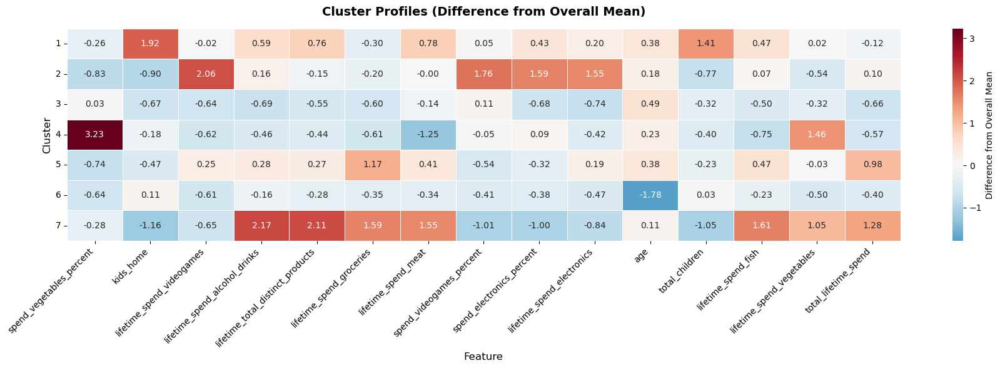

,age,degree_level_ordinal,distinct_stores_visited,kids_home,lifetime_spend_alcohol_drinks,lifetime_spend_electronics,lifetime_spend_fish,lifetime_spend_groceries,lifetime_spend_hygiene,lifetime_spend_meat,lifetime_spend_nonalcohol_drinks,lifetime_spend_petfood,lifetime_spend_vegetables,lifetime_spend_videogames,lifetime_total_distinct_products,loyalty_card,no_kids,number_complaints,percentage_of_products_bought_promotion,spend_alcohol_drinks_percent,spend_electronics_percent,spend_fish_percent,spend_groceries_percent,spend_hygiene_percent,spend_meat_percent,spend_nonalcohol_drinks_percent,spend_petfood_percent,spend_vegetables_percent,spend_videogames_percent,total_children,total_lifetime_spend,typical_hour
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,0.38,0.07,0.16,1.92,0.59,0.20,0.47,-0.30,0.36,0.78,0.70,0.20,0.02,-0.02,0.76,0.05,-0.11,0.05,-0.25,0.83,0.43,0.85,-0.62,0.32,0.59,0.81,0.00,-0.26,0.05,1.41,-0.12,-0.36
2,0.18,0.12,-0.75,-0.90,0.16,1.55,0.07,-0.20,-0.56,-0.00,0.06,-0.07,-0.54,2.06,-0.15,-0.21,0.40,0.13,-0.05,0.10,1.59,0.08,-0.78,-0.64,-0.17,-0.13,-0.33,-0.83,1.76,-0.77,0.10,0.31
3,0.49,-0.22,0.54,-0.67,-0.69,-0.74,-0.50,-0.60,-0.41,-0.14,-0.70,-0.03,-0.32,-0.64,-0.55,0.21,-0.02,-0.37,0.71,-0.61,-0.68,-0.05,0.26,0.21,0.99,-0.32,0.92,0.03,0.11,-0.32,-0.66,0.14
4,0.23,0.11,0.13,-0.18,-0.46,-0.42,-0.75,-0.61,-0.01,-1.25,-0.20,-0.35,1.46,-0.62,-0.44,-0.08,-0.11,-0.26,-0.61,-0.08,0.09,-0.86,-0.44,0.70,-0.95,0.64,0.26,3.23,-0.05,-0.40,-0.57,0.10
5,0.38,0.15,-0.08,-0.47,0.28,0.19,0.47,1.17,0.37,0.41,0.23,0.22,-0.03,0.25,0.27,0.07,-0.04,-0.73,-0.14,-0.39,-0.32,-0.18,0.60,-0.40,-0.43,-0.51,-0.60,-0.74,-0.54,-0.23,0.98,0.06
6,-1.78,-0.25,-0.15,0.11,-0.16,-0.47,-0.23,-0.35,-0.19,-0.34,-0.32,-0.20,-0.50,-0.61,-0.28,-0.15,0.02,1.57,0.33,0.31,-0.38,0.07,0.31,-0.04,-0.03,-0.16,0.08,-0.64,-0.41,0.03,-0.40,-0.12
7,0.11,-0.54,-0.47,-1.16,2.17,-0.84,1.61,1.59,-0.25,1.55,1.03,-0.76,1.05,-0.65,2.11,-0.58,0.88,0.32,-0.73,0.82,-1.00,0.63,0.66,-0.71,-0.02,-0.14,-0.92,-0.28,-1.01,-1.05,1.28,-0.55


In [81]:
# Generate new customer profiles
cluster_profiles = generate_cluster_profiles(info_df_clustered, top_n_features=15)
cluster_profiles

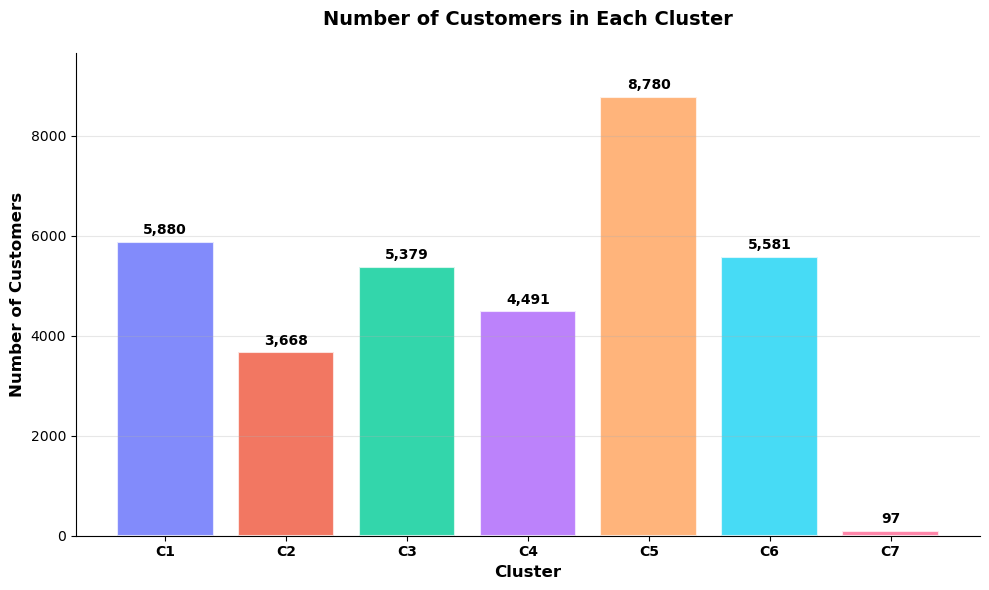

In [82]:
# Check the cluster sizes
plot_cluster_counts(info_df_clustered)

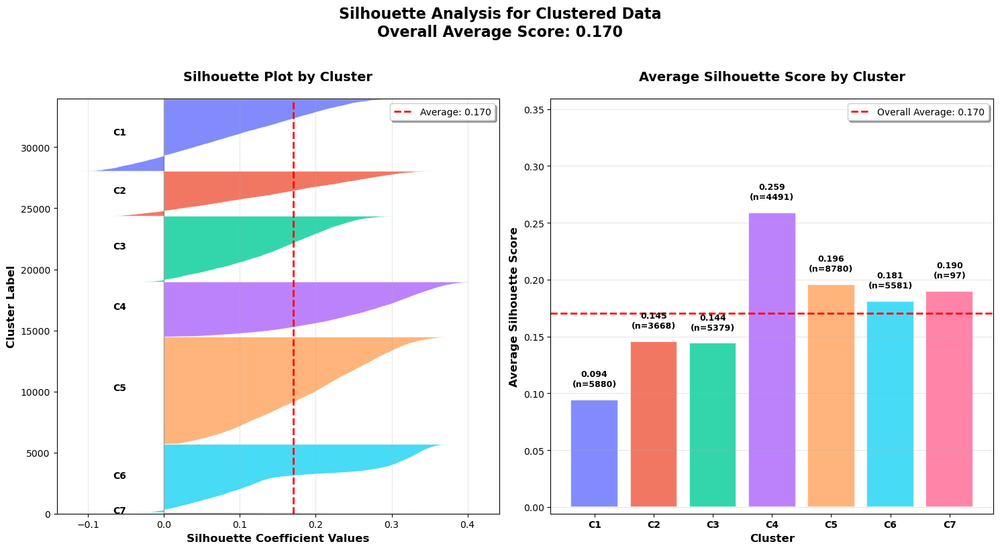

In [83]:
# Generate silhouette plot per cluster
silhouette_scores = plot_silhouette_analysis(info_df_clustered.drop(columns=['customer_id']))

In [84]:
# Generate cluster names (most significant features)
cluster_names = generate_cluster_names(cluster_profiles, z_threshold=0.7)

# Print cluster descriptions
for k, v in cluster_names.items():
    print(f"Cluster {k}: {v}\n")

Cluster 1: HIGH : kids home, total children, spend fish percent, spend alcohol drinks percent | LOW : spend groceries percent

Cluster 2: HIGH : lifetime spend videogames, spend videogames percent, spend electronics percent, lifetime spend electronics | LOW : kids home, spend vegetables percent, spend groceries percent, total children

Cluster 3: HIGH : spend meat percent, spend petfood percent, percentage of products bought promotion, distinct stores visited | LOW : lifetime spend electronics, lifetime spend nonalcohol drinks, lifetime spend alcohol drinks, spend electronics percent

Cluster 4: HIGH : spend vegetables percent, lifetime spend vegetables, spend hygiene percent, spend nonalcohol drinks percent | LOW : lifetime spend meat, spend meat percent, spend fish percent, lifetime spend fish

Cluster 5: HIGH : lifetime spend groceries, total lifetime spend, spend groceries percent | LOW : spend vegetables percent, number complaints, spend petfood percent, spend videogames percent



## Classifying the outliers

In [85]:
# Assign outliers to clusters based on the nearest cluster centroid
outliers_df_pca = assign_outliers_to_clusters(outliers_df_pca, info_df_pca.drop(columns=['customer_id']))

In [86]:
# Check to which clusters the outliers are assigned
outliers_df_pca['cluster'].value_counts()

cluster
2    90
1    40
5    35
3    18
6     1
Name: count, dtype: int64

In [87]:
# Merge the outliers with the clustered DataFrame
info_df_clustered = pd.concat([info_df_clustered, info_df_scaled.merge(outliers_df_pca[['customer_id', 'cluster']], on='customer_id', how='right')], axis=0).reset_index(drop=True)

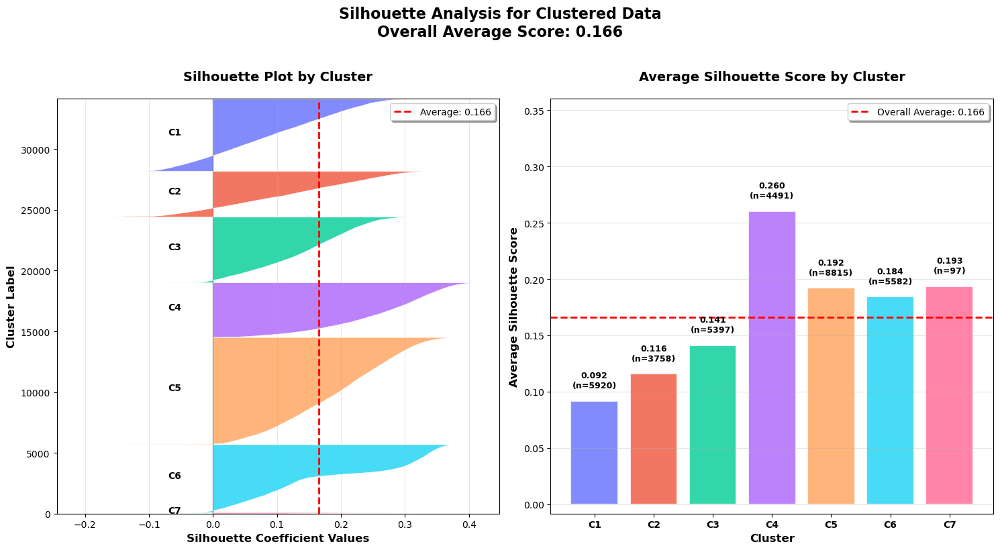

In [88]:
# Generate silhouette plot per cluster
silhouette_scores = plot_silhouette_analysis(info_df_clustered.drop(columns=['customer_id']))

## UMAP visualization

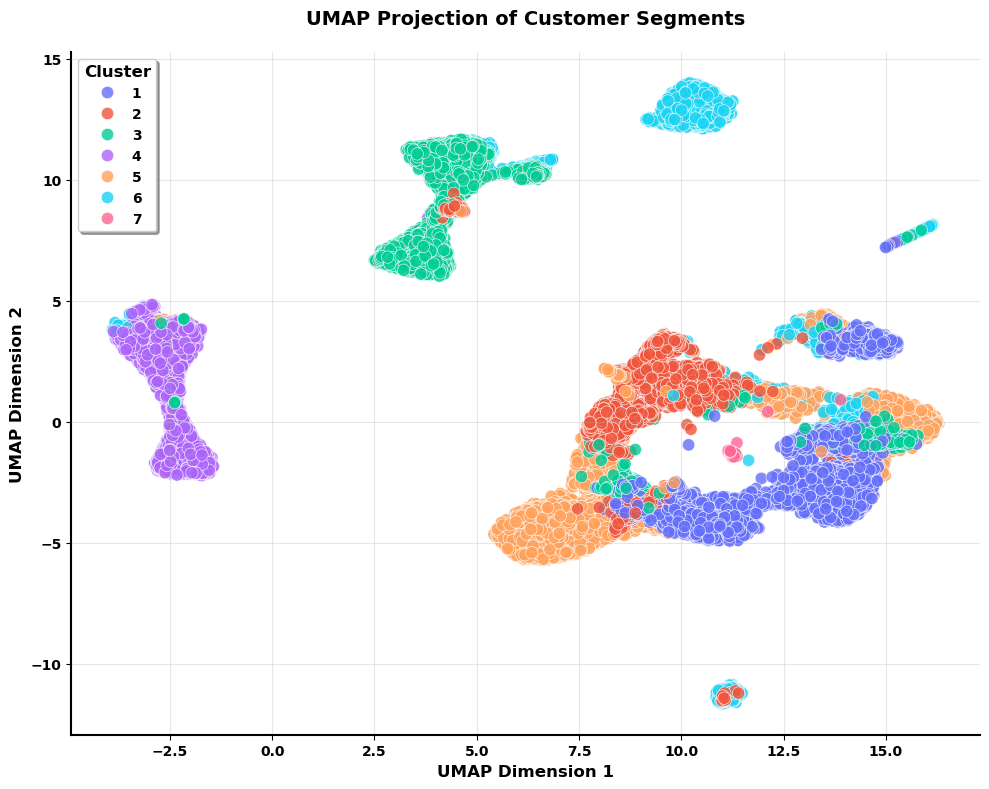

In [89]:
plot_umap_2d(info_df_clustered.drop(columns=['customer_id']))

In [90]:
plot_clusters_3d(info_df_clustered, 'umap')

## PCA visualization

In [91]:
plot_clusters_3d(info_df_clustered, 'pca')

## Cluster summary

In [92]:
# Merge the cluster labels from info_df_clustered into info_df using customer_id
info_df_with_cluster = info_df.merge(
    info_df_clustered[['customer_id', 'cluster']],
    on='customer_id',
    how='right'
)

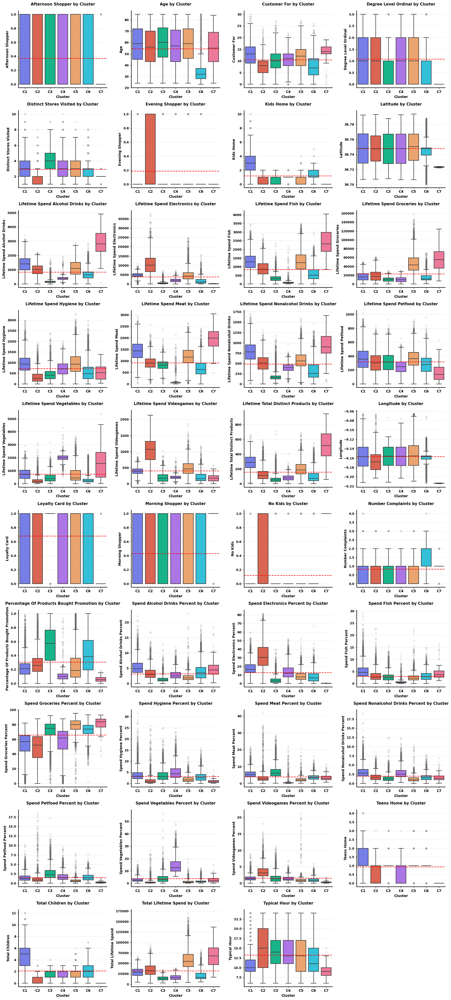

In [93]:
plot_cluster_boxplots(info_df_with_cluster.drop(columns=['customer_id']))

In [94]:
plot_clusters_map(info_df_with_cluster)

In [95]:
# Save the clustered data
info_df_clustered[['customer_id', 'cluster']].to_csv('customer_clusters.csv', index=False)

# Association Rules

In [96]:
basket_df_clustered = basket_df.merge(info_df_clustered[['customer_id', 'cluster']], on='customer_id', how='inner')

In [97]:
# Define descriptive cluster names based on the profiling
cluster_labels = {
    1: "Family Shoppers",
    2: "Tech & Gaming Enthusiasts",
    3: "Balanced Budget Shoppers",
    4: "Healthy Shoppers",
    5: "Big Spenders",
    6: "Students",
    7: "Business Owner Makro"
}

In [98]:
# Create a mapping of cluster to optimal support for association rules
optimal_supports = {
    1: 0.12,
    2: 0.15,
    3: 0.04,
    4: 0.08,
    5: 0.03,
    6: 0.03,
    7: 0.1
}

In [99]:
basket_df_clustered['cluster'].unique()

array([2, 3, 5, 4, 1, 6, 7], dtype=int64)

In [100]:
# Get association rules for each cluster
for cluster in sorted(basket_df_clustered['cluster'].unique()):

    # Get the cluster baskets
    df = basket_df_clustered[basket_df_clustered['cluster'] == cluster]

    print(f"Cluster: {cluster_labels[cluster]}")
    result = get_association_rules(df, optimal_supports[cluster])


    # Display results
    print("Top Association Rules by Lift:")
    print(result[:5], '\n\n')

Cluster: Family Shoppers
Top Association Rules by Lift:
            antecedents        consequents      lift   support  confidence
20          (minecraft)  (ratchet & clank)  1.289890  0.215492    0.600559
25  (ratchet & clank 2)  (ratchet & clank)  1.287220  0.126943    0.599316
10      (pokemon sword)      (babies food)  1.265694  0.127111    0.829455
14  (ratchet & clank 2)      (babies food)  1.262982  0.175313    0.827677
6           (minecraft)      (babies food)  1.257907  0.295793    0.824352 


Cluster: Tech & Gaming Enthusiasts
Top Association Rules by Lift:
                      antecedents     consequents      lift   support  \
3                    (energy bar)  (energy drink)  1.479612  0.170978   
10                  (protein bar)      (pancakes)  1.472319  0.185562   
7                      (pancakes)  (energy drink)  1.467306  0.327738   
9                   (protein bar)  (energy drink)  1.438970  0.250963   
5   (gadget for tiktok streaming)  (energy drink)  1.299103 

In [102]:
# This was used to get the optimal_supports
cluster = 7  # Change this to the desired cluster number
df = basket_df_clustered[basket_df_clustered['cluster'] == cluster]

for i in range(10, 240, 10):
    print(f"Cluster: {cluster} - {cluster_names[cluster]}")
    result = get_association_rules(df, i/1000)

    # Display results
    print("Top Association Rules by Lift:")
    print(result[:10], '\n\n')

Cluster: 7 - HIGH : lifetime spend alcohol drinks, lifetime total distinct products, lifetime spend fish, lifetime spend groceries | LOW : kids home, total children, spend videogames percent, spend electronics percent
Top Association Rules by Lift:
              antecedents         consequents       lift   support  confidence
1061     (megaman zero 4)     (mashed potato)  19.133333  0.010453    0.600000
594                (corn)             (cider)  11.038462  0.010453    0.500000
1433     (pokemon violet)           (pickles)   9.566667  0.010453    0.333333
1066     (megaman zero 3)        (mayonnaise)   8.968750  0.010453    0.500000
1558      (strong cheese)   (sparkling water)   7.827273  0.010453    0.600000
22    (antioxydant juice)  (whole wheat rice)   7.486957  0.010453    0.600000
4               (almonds)         (flax seed)   7.358974  0.010453    0.333333
990    (hand protein bar)           (ketchup)   7.175000  0.010453    0.500000
1053        (light cream)    (vegetables